In [7]:
from google.colab import drive
drive.mount('/content/drive')

#drive_dir_path = "/content/drive/MyDrive/picture_embeddings"
#! mkdir -p {drive_dir_path}
#import os
#cwd = os.getcwd() 
#data_dir = os.path.join(drive_dir_path, 'data')
#root = ""#os.path.join(drive_dir_path, 'images', 'val2017')
#annFile = ""#os.path.join(drive_dir_path, 'annotations', 'instances_val2017.json')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [8]:
from google.colab.output import eval_js
def shrink(height="300"):
    eval_js(f'google.colab.output.setIframeHeight({height})')

Get the data - only need to run once

In [3]:
!wget https://cs7643-raml.s3.us-west-2.amazonaws.com/valid_subset_np_imgs.zip
!wget https://cs7643-raml.s3.us-west-2.amazonaws.com/instances_valid_subset.json
!wget https://cs7643-raml.s3.us-west-2.amazonaws.com/categories.json
!wget https://cs7643-raml.s3.us-west-2.amazonaws.com/imgs_by_supercategory.json
!wget https://cs7643-raml.s3.us-west-2.amazonaws.com/val_np_imgs.zip

--2021-07-30 20:26:48--  https://cs7643-raml.s3.us-west-2.amazonaws.com/valid_subset_np_imgs.zip
Resolving cs7643-raml.s3.us-west-2.amazonaws.com (cs7643-raml.s3.us-west-2.amazonaws.com)... 52.218.251.49
Connecting to cs7643-raml.s3.us-west-2.amazonaws.com (cs7643-raml.s3.us-west-2.amazonaws.com)|52.218.251.49|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2915042448 (2.7G) [application/zip]
Saving to: ‘valid_subset_np_imgs.zip’

valid_subset_np_img   1%[                    ]  36.24M  14.6MB/s               ^C
--2021-07-30 20:26:51--  https://cs7643-raml.s3.us-west-2.amazonaws.com/instances_valid_subset.json
Resolving cs7643-raml.s3.us-west-2.amazonaws.com (cs7643-raml.s3.us-west-2.amazonaws.com)... 52.218.251.49
Connecting to cs7643-raml.s3.us-west-2.amazonaws.com (cs7643-raml.s3.us-west-2.amazonaws.com)|52.218.251.49|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 580614542 (554M) [application/json]
Saving to: ‘instances_valid_subs

In [9]:
numpy_data_path = "/content/drive/MyDrive/numpy_images"

In [18]:
! mkdir -p {numpy_data_path}/data
! #unzip -q valid_subset_np_imgs.zip -d {numpy_data_path}/data
! #unzip -q val_np_imgs.zip -d {numpy_data_path}/data
! mkdir -p {numpy_data_path}/annotations
! mv instances_valid_subset.json  {numpy_data_path}/annotations
! mv categories.json {numpy_data_path}/annotations
! mv imgs_by_supercategory.json {numpy_data_path}/annotations

mv: cannot stat 'instances_valid_subset.json': No such file or directory
mv: cannot stat 'categories.json': No such file or directory
mv: cannot stat 'imgs_by_supercategory.json': No such file or directory


Set up environment

In [10]:
! pip install --upgrade pip
! pip install torch torchvision torchsummary gca pandas numpy matplotlib seaborn scikit-learn==0.23.2 pycocotools tqdm umap-learn kneed
! pip install git+https://github.com/waleedka/cocoapi.git#egg=pycocotools&subdirectory=PythonAPI
# TODO: install the docem python package via github
! pip list
shrink()

distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/include/python3.7/UNKNOWN
sysconfig: /usr/include/python3.7m/UNKNOWN
distutils: /usr/local/bin
sysconfig: /usr/bin
distutils: /usr/local
sysconfig: /usr
user = False
home = None
root = None
prefix = None
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/include/python3.7/UNKNOWN
sysconfig: /usr/include/python3.7m/UNKNOWN
distutils: /usr/local/bin
sysconfig: /usr/bin
distutils: /usr/local
sysconfig: /usr
user = False
home = None
root = None
prefix = None
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.

Choose a GPU runtime

In [11]:
import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
if torch.cuda.is_available():
    print(torch.cuda.current_device())
    print(torch.cuda.device_count())
    print(torch.cuda.get_device_name(0))
    
device

0
1
Tesla T4


device(type='cuda', index=0)

Load the resnext model

In [6]:
# small size model
model = torch.hub.load('facebookresearch/WSL-Images', 'resnext101_32x8d_wsl')

Downloading: "https://github.com/facebookresearch/WSL-Images/archive/master.zip" to /root/.cache/torch/hub/master.zip
Downloading: "https://download.pytorch.org/models/ig_resnext101_32x8-c38310e5.pth" to /root/.cache/torch/hub/checkpoints/ig_resnext101_32x8-c38310e5.pth


Remove last FC layer

In [7]:
from torch import nn
from torchsummary import summary

# Dropping output layer (the ImageNet classifier)

def slice_model(original_model, from_layer=None, to_layer=None):
    return nn.Sequential(*list(original_model.children())[from_layer:to_layer])
model_conv_features = slice_model(model, to_layer=-1).to(device)
summary(model_conv_features, input_size=(3,224,224))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5          [-1, 256, 56, 56]          16,384
       BatchNorm2d-6          [-1, 256, 56, 56]             512
              ReLU-7          [-1, 256, 56, 56]               0
            Conv2d-8          [-1, 256, 56, 56]          18,432
       BatchNorm2d-9          [-1, 256, 56, 56]             512
             ReLU-10          [-1, 256, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          65,536
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

Custom CocoDataset

In [12]:
import os
import multiprocessing as mp
import random
import sys

In [9]:
sys.path.append("/content/drive/MyDrive/dataset")
#import coco_api_helper
#import coco_data_prep
#import config_dataset

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import torch 
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm

In [11]:
import os
import json
with open (os.path.join(numpy_data_path, "annotations","categories.json"), 'r') as j:
    desired_categories = json.load(j)
#with open (os.path.join(numpy_data_path, "annotations", "imgs_by_supercategory.json"), 'r') as f:
#    imgid_by_supercat = json.load(f)
valid_annot = COCO("/content/drive/MyDrive/numpy_images/annotations/instances_val2014.json")
category_ids = [cat["id"] for cat in desired_categories]
img_ids = [valid_annot.getImgIds(catIds=[id]) for id in category_ids]


# flatten to a list of imgids
desired_img_ids = list(set([ii for img_id in img_ids for ii in img_id]))

loading annotations into memory...
Done (t=9.78s)
creating index...
index created!


In [12]:
test = valid_annot.loadImgs(desired_img_ids)
subset_list = os.listdir("/content/drive/MyDrive/numpy_images/data/valid_subset")
test_dict = dict(zip(desired_img_ids, [item["file_name"].replace(".jpg",".np") for item in test]))
final = {k: v for (k, v) in test_dict.items() if v in subset_list}
desired_img_ids = list(final.keys())

In [13]:
class COCODataset(Dataset):
    def __init__(self,
                 np_img_data_dir,
                 annot_filepath,
                 sample_ratio: float = None,
                 device="cpu"):
        """
        :np_img_data_dir: local directory where you have unzipped np files saved 
            np files are the trasnformed images from s3 that were normalized/ resized/ padded
        :annot_filepath: filepath of the original coco dataset corresponding to the datasplit of your choosing
        :sample_ratio: specified float between 0 and 1 for the % of images from the data split you want to use
        :device: cpu or gpu
        """
        self.device = device
        self.np_img_data_dir = np_img_data_dir

        self.sample_ratio = sample_ratio
        self.coco = COCO(annot_filepath)

        # All possible image ids
        all_train_img_ids = list(self.coco.imgs.keys())
        # Filter down to the image ids applicable to our supercategories
        
        self.ids = [ii for ii in tqdm(all_train_img_ids) if ii in desired_img_ids]

        if self.sample_ratio is None:
            pass
        else:
            self.ids = list(np.random.choice(self.ids, int(self.sample_ratio * len(self.ids)), replace=False))

    def __getitem__(self, index):
        coco = self.coco

        img_id = self.ids[index]
        ann_ids = coco.getAnnIds(imgIds=[img_id])
        target = coco.loadAnns(ann_ids)

        path = coco.loadImgs([img_id])[0]['file_name']
        np_path = path.split('.')[0] + '.np'
        img = np.load(os.path.join(self.np_img_data_dir, np_path))
        
        # Convert the image to tensor so it's compatible w/ pytorch data loader
        img = torch.Tensor(img.transpose(2,0,1)).to(device=self.device).float()

        return img, target

    def __len__(self):
        return len(self.ids)
    
def get_dataloader(dataset_obj,
                   batch_size: int=100,
                   device=torch.device("cuda:0" if torch.cuda.is_available() else "cpu"),
                   loader_params:dict = {"shuffle" : False,
                                         "num_workers": mp.cpu_count(),
                                         "collate_fn": lambda x: x}):
    """Returns data loader for custom dataset.
    Args:
        :dataset_obj: dataset object returned from COCODataset class
        :batch_size: specified batch size, if you have memory errors while running, make this smaller
        :device: default is CUDA if there is GPU otherwise CPU
        :loader_params: default is found in config_dataset.py's dataloader_params dict
            can specify your own data loader params, but collate_fn must be `lambda x: x`
            specify:
                shuffle: True / False
                num_workers: number of parallel processes to run
                collate_fn: lambda x: x
    Returns:
        data_loader: data loader for COCODataset.
    """
    # data loader for custom dataset
    # this will return (imgs, targets) for each iteration
    loader_params.update({'batch_size': batch_size})
    
    data_loader = DataLoader(
        dataset=dataset_obj, 
        **loader_params,
    )
    return data_loader


Dataset and DataLoader

In [14]:
np_data_dir = "/content/drive/MyDrive/numpy_images/data/valid_subset"
np_annot_dir = "/content/drive/MyDrive/numpy_images/annotations/instances_val2014.json"

In [15]:
len(desired_img_ids)

15989

In [16]:
len(os.listdir(np_data_dir))

15989

In [17]:
val_dataset = COCODataset(np_data_dir, np_annot_dir, sample_ratio=None)

loading annotations into memory...
Done (t=5.98s)
creating index...


  0%|          | 164/40504 [00:00<00:24, 1638.22it/s]

index created!


100%|██████████| 40504/40504 [00:19<00:00, 2059.20it/s]


In [18]:
from torch.utils.data import DataLoader
from torch.multiprocessing import Pool, Process, set_start_method
import torch.multiprocessing
cpu_count = torch.multiprocessing.cpu_count()
print('cpus', cpu_count)

try: 
  set_start_method("spawn")
except RuntimeError:
  pass
batch_size = 64

val_dl = torch.utils.data.DataLoader(dataset=val_dataset, 
                                          batch_size=batch_size,
                                          shuffle=False,
                                          num_workers=cpu_count,
                                          collate_fn=lambda x: x)

cpus 2


In [19]:
from tqdm import tqdm

Generate embeddings

In [21]:
features_list = []
labels_list = []

# Use GPUs to speed up the inference, this should take around 10 minutes

model_conv_features.to(device)
for batch in tqdm(val_dl):
    image_batch, label_batch = [x[0] for x in batch], [x[1] for x in batch]
    image_batch = torch.stack(image_batch).to(device) 

    with torch.no_grad():
        features_batch = model_conv_features(image_batch).flatten(start_dim=1)
    features_list.append(features_batch)
    labels_list.extend(label_batch)


 14%|█▍        | 35/250 [00:26<02:44,  1.31it/s]

ValueError: ignored

In [ ]:
features = torch.cat(features_list)
features.shape

In [ ]:
X = features.to("cpu").numpy()

Embedding to image_id mapping

In [ ]:
image_map = [item[0]["image_id"] for item in labels_list]
embed_pos_to_image_id = dict(zip(range(len(image_map)), image_map))

In [ ]:
print(embed_pos_to_image_id)

In [ ]:
# extract and concat labels, None in case of multiple labels
from collections import Counter

category_labels=[]
category_multi_labels = []
category_multi_labels_counts = []
supercategory_labels = []
supercategory_multi_labels = []
supercategory_multi_labels_counts = []
image_ids = []


coco=COCO(np_annot_dir)
cats = coco.loadCats(coco.getCatIds())
cat_id_to_name_dict = {cat['id']: cat['name'] for cat in cats}


cats_dict = {cat['id']: cat for cat in cats}
for label in labels_list:
    
    if len(label) > 0:
        categories = []
        supercategories = []
        
        for annotation in label:
            categories.append(cats_dict[annotation['category_id']]['name'])
            supercategories.append(cats_dict[annotation['category_id']]['supercategory'])
        category_multi_labels_counts.append(categories)
        category_multi_labels.append(list(set(categories)))
        supercategory_multi_labels.append(list(set(supercategories)))
        supercategory_multi_labels_counts.append(supercategories)

        # most common category among objects in the picture
        category, _ = Counter(categories).most_common(1)[0]
        supercategory, _ = Counter(supercategories).most_common(1)[0]
        
        image_ids.append(label[0]['image_id'])
        category_labels.append(category)
        supercategory_labels.append(supercategory)
    else:
        supercategory_multi_labels.append([])
        supercategory_multi_labels_counts.append([])
        category_multi_labels.append([])
        category_multi_labels_counts.append([])
        category_labels.append(None)
        supercategory_labels.append(None)
        image_ids.append(None)
        
len(category_labels), len(supercategory_labels), len(image_ids), len(supercategory_multi_labels), len(category_multi_labels), len(supercategory_multi_labels_counts), len(category_multi_labels_counts)

In [23]:
import os
import json
print(os.getcwd())

os.chdir("/content/drive/MyDrive/numpy_images/")
print(os.listdir())

embeddings_path = "resnext_embeddings.pt"
mapping_path = "resnext_embeddings.json"
embeddings = torch.load(embeddings_path,map_location=torch.device('cpu'))

with open(mapping_path, 'r') as fp:
    idx2Img = json.load(fp)
    
idx2Img = dict(zip(list(map(int, idx2Img.keys())), list(idx2Img.values())))
print(idx2Img)


/content/drive/MyDrive/numpy_images
['data', 'annotations', 'resnext_embeddings.json', 'resnext_embeddings.pt']
{0: 184613, 1: 397133, 2: 574769, 3: 374628, 4: 328757, 5: 293802, 6: 37777, 7: 384553, 8: 368402, 9: 87038, 10: 515289, 11: 562150, 12: 173350, 13: 383445, 14: 565797, 15: 394892, 16: 310391, 17: 241876, 18: 462341, 19: 122851, 20: 138246, 21: 197254, 22: 37675, 23: 296649, 24: 19358, 25: 184791, 26: 74331, 27: 579664, 28: 452684, 29: 527040, 30: 350341, 31: 281533, 32: 289393, 33: 281221, 34: 354533, 35: 181666, 36: 545959, 37: 511058, 38: 91227, 39: 334321, 40: 207797, 41: 179558, 42: 15085, 43: 467522, 44: 40102, 45: 403020, 46: 6005, 47: 402559, 48: 189550, 49: 505440, 50: 241691, 51: 290570, 52: 28758, 53: 163020, 54: 281455, 55: 17756, 56: 155885, 57: 231408, 58: 305821, 59: 190056, 60: 121041, 61: 156397, 62: 173574, 63: 208589, 64: 267571, 65: 73830, 66: 82258, 67: 95022, 68: 153299, 69: 216482, 70: 8665, 71: 573291, 72: 161470, 73: 452224, 74: 564563, 75: 93201, 76:

resnext_embeddings.json


In [16]:
# Img Ids to query
random.seed(10)
query_images = random.sample(list(idx2Img.values()), 10)
print(query_images)
# Position of query images in embedding space
query_idxs = [key for key, value in idx2Img.items() if idx2Img[key] in query_images]

print("query image ids: ", query_images)
print("query image idxs: ", query_idxs)

[558661, 123071, 535156, 185614, 8493, 538859, 10583, 254976, 176847, 369594]
query image ids:  [558661, 123071, 535156, 185614, 8493, 538859, 10583, 254976, 176847, 369594]
query image idxs:  [486, 1067, 6753, 9093, 14053, 15157, 15812, 16098, 18723, 18942]


In [17]:

# Update based on the location in your system
annot_file = "annotations/instances_val2014.json"


In [66]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=30, random_state=0).fit(embeddings)
kmeans.labels_
print(kmeans.labels_.shape)
kmeans.cluster_centers_
print(kmeans.cluster_centers_.shape)

(20874,)
(30, 2048)


In [ ]:
# import hierarchical clustering libraries
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering
# create dendrogram
dendrogram = sch.dendrogram(sch.linkage(embeddings, method='ward'))
# create clusters
hc = AgglomerativeClustering(n_clusters=30, affinity = 'euclidean', linkage = 'ward')
# save clusters for chart
y_hc = hc.fit_predict(embeddings)

In [18]:
!pip install faiss-gpu



distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/include/python3.7/UNKNOWN
sysconfig: /usr/include/python3.7m/UNKNOWN
distutils: /usr/local/bin
sysconfig: /usr/bin
distutils: /usr/local
sysconfig: /usr
user = False
home = None
root = None
prefix = None


In [19]:
print(embeddings.shape)
em_np = embeddings.cpu().numpy()
print(type(em_np))

torch.Size([20874, 2048])
<class 'numpy.ndarray'>


In [33]:
query_embedding = em_np[query_idxs]
print(query_embedding.shape)

(10, 2048)


In [34]:
import faiss
index = faiss.IndexFlatL2(embeddings.shape[1])   # build the index
print(index.is_trained)
index.train(em_np)
index.add(em_np)                  # add vectors to the index
print(index.ntotal)

True
20874


In [39]:
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
import numpy as np
import itertools
from pycocotools.coco import COCO
from mpl_toolkits.mplot3d import Axes3D
from collections import Counter
import pandas as pd

class EmbeddingPlotter:
    def __init__(self, annot_file, embeddings, idx2Img):
        self.annot_file = annot_file
        self.coco = COCO(self.annot_file)
        cats = self.coco.loadCats(self.coco.getCatIds())
        self.cat_id_to_name_dict = {cat['id']: cat['name'] for cat in cats}
        self.img_ids = list(idx2Img.values())
        self.annIds = self.coco.getAnnIds(self.img_ids)
        #self.labels = [self.coco.loadAnns(self.annIds)]
        
        
        
        
        self.embeddings = embeddings
        self.idx2Img = idx2Img
        self.labels = []
        for k, v in self.idx2Img.items():
            ann_ids_to_append = self.coco.getAnnIds(self.idx2Img[k])
            anns_to_append = self.coco.loadAnns(ann_ids_to_append)
            self.labels.append(anns_to_append)
            
        
        self.category_labels=[]
        # self.category_multi_labels = []
        # self.category_multi_labels_counts = []
        self.supercategory_labels = []
        # self.supercategory_multi_labels = []
        # self.supercategory_multi_labels_counts = []
        
        
 
        
        cats_dict = {cat['id']: cat for cat in cats}
        for label in self.labels:
            
            if len(label) > 0:
                categories = []
                supercategories = []
                
                for annotation in label:
                    categories.append(cats_dict[annotation['category_id']]['name'])
                    supercategories.append(cats_dict[annotation['category_id']]['supercategory'])
                # self.category_multi_labels_counts.append(categories)
                # self.category_multi_labels.append(list(set(categories)))
                # self.supercategory_multi_labels.append(list(set(supercategories)))
                # self.supercategory_multi_labels_counts.append(supercategories)
        
                # most common category among objects in the picture
                category, _ = Counter(categories).most_common(1)[0]
                supercategory, _ = Counter(supercategories).most_common(1)[0]
                
                self.category_labels.append(category)
                self.supercategory_labels.append(supercategory)
            else:
                # self.supercategory_multi_labels.append([])
                # self.supercategory_multi_labels_counts.append([])
                # self.category_multi_labels.append([])
                # self.category_multi_labels_counts.append([])
                self.category_labels.append(None)
                self.supercategory_labels.append(None)
        
    def plot_coco_images(self, img_ids, show_labels=True,
                         show_annotations=False, title_suffix=None, figtitle=None):
        coco = self.coco
        cat_id_to_name_dict = self.cat_id_to_name_dict
        nrows = len(img_ids)
        ncols = len(img_ids[0])
    
        fig = plt.figure(figsize=(ncols*6, nrows*6))
    
        for i, img_id in enumerate(itertools.chain(*img_ids)):
            ax = fig.add_subplot(nrows, ncols, i+1)
            img = coco.loadImgs(img_id)[0]
            I = io.imread(img['coco_url'])
    
            ax.imshow(I, aspect='equal', )
            ax.axis('off')
            
            if title_suffix is not None:
                title=f'{img_id}: {title_suffix[i//nrows, i%ncols]}'
            else:
                title = str(img_id)
            ax.set_title(title)
    
        
            annIds = coco.getAnnIds(imgIds=img['id'], iscrowd=None)
            anns = coco.loadAnns(annIds)
            if show_annotations:
                coco.showAnns(anns)
    
            if show_labels:
                for ann in anns:
                    [x, y, _, _] = ann['bbox']
                    label = cat_id_to_name_dict[ann['category_id']]
    
                    t=ax.annotate(label, (x,y), fontsize=12)
                    t.set_bbox(dict(facecolor='white', alpha=0.2, edgecolor='white'))
    
        plt.tight_layout()
        
        if figtitle:
            fig.suptitle(figtitle)
            plt.subplots_adjust(top=0.90)
        plt.show()
        
    def plot_neighbors(self, X_idx, nbrs, show_annotations=False):
        idx2Img = self.idx2Img
        embeddings = self.embeddings
        m, n = np.shape(embeddings)
        img_id = idx2Img[X_idx]
        
        distances, indices = nbrs.kneighbors(embeddings[X_idx, :].reshape(1, n), 16)
        distances, indices = distances[0], indices[0]
        neighbors_ids = np.array(list(map(idx2Img.get, indices)))
        np.insert(neighbors_ids, 0, img_id)
        np.insert(distances, 0, 0)
        
        title_suffix = np.array([f'distance={distance:.2f}' for distance in distances])
        figtitle=f'Neighbors of {img_id}'
        self.plot_coco_images(neighbors_ids.reshape(4, 4).tolist(), 
                         title_suffix=title_suffix.reshape(4,4),
                         show_annotations=show_annotations,
                         figtitle=figtitle)
        
    def plot_3d(self, X, title=None, columns=['x0', 'x1', 'x2'], **kwargs):
        labels = self.supercategory_labels
        
        
        
        df = pd.DataFrame(X, columns=columns)
        df['label'] = labels
        cmap = plt.get_cmap('gist_rainbow')
        unique_labels = list(set(labels))
        labels_dict = {label: i for i, label in enumerate(unique_labels)}
        num_colors = len(unique_labels)
        c = [cmap(1.*labels_dict[label]/num_colors) for label in labels]
    
        df['c'] = c
        df = df[~df['label'].isna()]
        ax = plt.figure(figsize=(16,10)).gca(projection='3d')
        
        for label, grp in df.groupby('label'):
            ax.scatter(
            xs=grp[columns[0]], 
            ys=grp[columns[1]], 
            zs=grp[columns[2]], 
            c=grp['c'], 
            label=label,
            **kwargs
        #     cmap='gist_rainbow'
        )
        
        ax.set_xlabel(columns[0])
        ax.set_ylabel(columns[1])
        ax.set_zlabel(columns[2])
        
        plt.legend(loc='best')
        if title:
            plt.title(title)
        plt.show()

In [40]:
plotter = EmbeddingPlotter(annot_file = annot_file, embeddings=embeddings, idx2Img=idx2Img)

loading annotations into memory...
Done (t=7.07s)
creating index...
index created!


In [38]:

k = 6                         # we want to see 5 nearest neighbors
D, I = index.search(query_embedding, k) # sanity check
print(I)
print(D)

[[  486  2563   371  8864  2037 20806]
 [ 1067  2537 19481  8440  1047 10676]
 [ 6753 18842 12115   314 18440  2628]
 [ 9093  9094  1131   587 14471 15491]
 [14053  4427 14052   748 16677  8637]
 [15157 15158  5910 19191  5912 20232]
 [15812 17530 14246  4267  1598 14224]
 [16098 20641 14002 14549 20127 17120]
 [18723 19216  2602  5501  7428 11649]
 [18942 20425  7922 15912 18352 13738]]
[[  0.      624.42773 625.5535  630.9129  637.1922  644.15845]
 [  0.      443.91443 460.28345 470.73502 482.83618 488.2774 ]
 [  0.      722.1201  723.8967  743.469   765.5708  768.9572 ]
 [  0.      146.17256 529.16174 565.10736 573.7912  634.39386]
 [  0.      274.79315 277.6357  285.01813 287.5379  295.10626]
 [  0.      401.33105 682.9413  722.0916  729.59656 740.0035 ]
 [  0.      795.719   802.95276 821.952   848.0599  851.26434]
 [  0.      586.0892  646.307   673.17365 751.99347 762.6033 ]
 [  0.      706.15485 728.18353 740.0694  767.71875 804.1105 ]
 [  0.      763.8494  814.22504 855.6256  

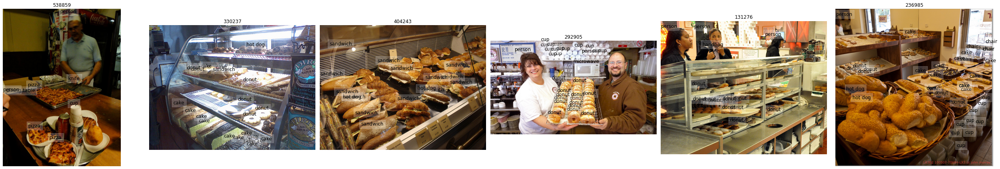

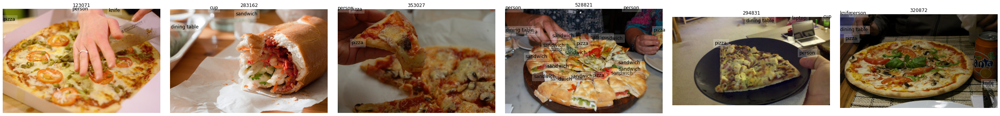

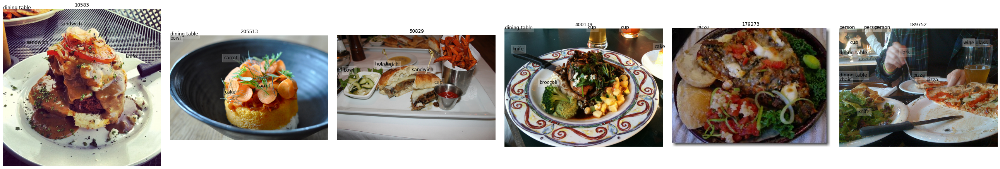

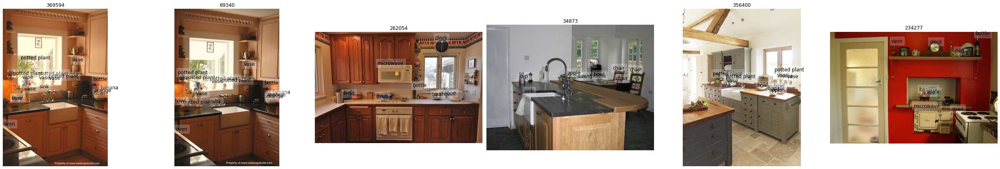

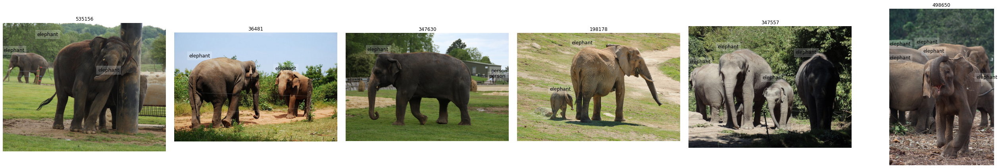

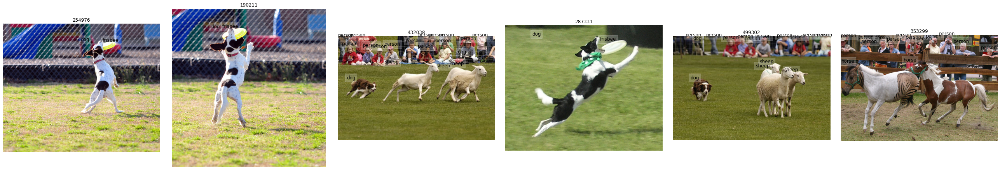

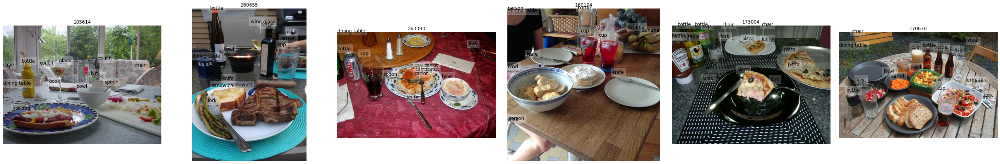

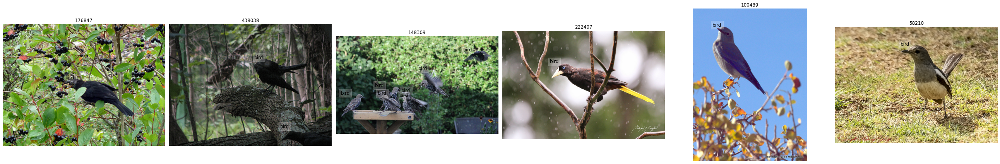

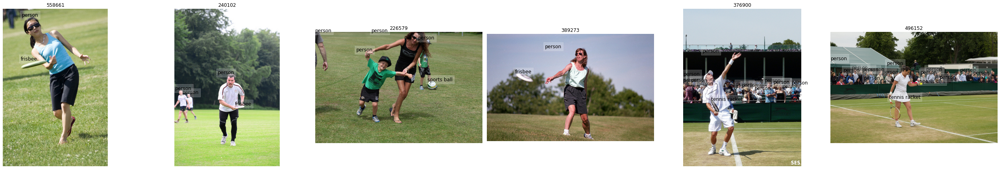

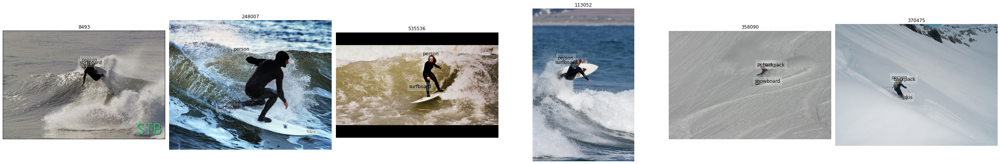

In [66]:
for j in range(I.shape[0]):
  l = []
  for i in range(I.shape[1]):
    l.append(idx2Img[I[j][i]])
  plotter.plot_coco_images([l])
